# Task 4 : Image Reconstruction using Matrix Factorisation [4 Marks]

In [8]:
import torch
import torchvision

device = torch.device('mps' if torch.backends.mps.is_available() else 'cpu')

import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
from latexify import latexify, format_axes

from utils import mask_image, factorize, metrics, random_mask_image, train, create_rff_features, create_linear_model, extract_not_nan_coordinates_pixels, create_coordinate_map

## Question 1
Pick an image of your liking and reconstruct it using matrix factorization. Choose a suitable value for the rank $r$. Run Gradient Descent until it converges, plot the reconstructed image alongside the original image. Calculate and report the RMSE and PSNR metrics. [1 Marks]

In [9]:
def plot_image_completion(img,
                          prop_list,
                          factors_list,
                          device): 
    
    latexify()
    fig = plt.figure(figsize=(len(factors_list) * 4, len(prop_list) * 18), dpi=300)
    gs = GridSpec(3*len(prop_list)+1, len(factors_list), figure=fig)
    
    curr_row = 0
    for i, prop in enumerate(prop_list):
        masked_img, mask = mask_image(img=img,
                                  prop=prop,
                                  device=device)
        
        axorg = fig.add_subplot(gs[curr_row, 0:len(factors_list)//2])
        axmask = fig.add_subplot(gs[curr_row, len(factors_list)//2:])
        curr_row += 1

        axorg.imshow(img.permute(1,2,0).cpu().numpy())
        axorg.set_title(f"Original image")
        format_axes(axorg)

        axmask.imshow(masked_img.permute(1,2,0).cpu().numpy())
        axmask.set_title(f"Masked image with prop={prop}")
        format_axes(axmask)

        rmses = []
        psnrs = []
        for j, r in enumerate(factors_list):
            Wr, Hr, lossr = factorize(masked_img[0], r, device=device)
            Wg, Hg, lossg = factorize(masked_img[1], r, device=device)
            Wb, Hb, lossb = factorize(masked_img[2], r, device=device)
            reconstructed_img = torch.clamp(torch.stack([torch.mm(Wr, Hr).detach(), torch.mm(Wg, Hg).detach(), torch.mm(Wb, Hb).detach()], dim=0), 0, 1)

            rmse, psnr = metrics(img, reconstructed_img)
        
            rmses.append(rmse.cpu().numpy())
            psnrs.append(psnr.cpu().numpy())

            # Plot reconstructed image with metrics in the loop
            ax = fig.add_subplot(gs[curr_row, j])
            ax.imshow(reconstructed_img.permute(1,2,0).cpu().numpy())
            ax.set_title(f"prop= {prop}, r={r}, RMSE={rmse:.4f}, PSNR={psnr:.4f}")
            format_axes(ax)
        curr_row += 1
        # Plot RMSE and PSNR vs r outside the loop
        axrmse = fig.add_subplot(gs[curr_row,0:len(factors_list)//2])
        axrmse.plot(factors_list, rmses, marker='o')
        axrmse.set_xlabel('r')
        axrmse.set_ylabel('RMSE')
        axrmse.set_title('RMSE vs r')
        format_axes(axrmse)
        axpsnr = fig.add_subplot(gs[curr_row,len(factors_list)//2:])
        axpsnr.plot(factors_list, psnrs, marker='o')
        axpsnr.set_xlabel('r')
        axpsnr.set_ylabel('PSNR')
        axpsnr.set_title('PSNR vs r')
        format_axes(axpsnr)
        curr_row += 1

    # Make the layout tight for better appearance
    plt.tight_layout()
    plt.show()

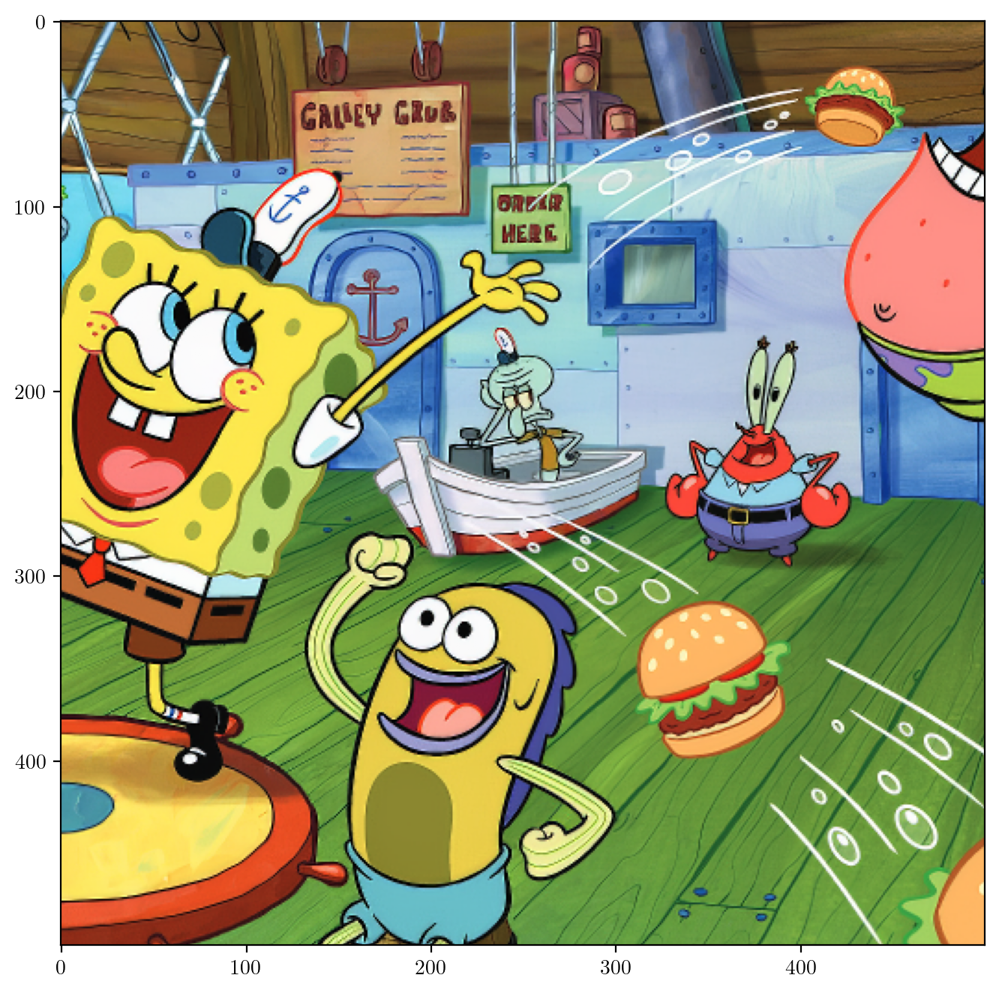

In [10]:
krustykrab = torchvision.io.read_image("images/krustykrab.png")
krustykrab = krustykrab.to(dtype=torch.float32, device=device)/255

transform = torchvision.transforms.CenterCrop((500, 500))

krustykrab = transform(krustykrab)

plt.figure(figsize=(12, 8))  
plt.imshow(krustykrab.permute(1,2,0).cpu().numpy())
plt.show()

In [11]:
plot_image_completion(krustykrab, prop_list=[0.1, 0.4, 0.8], factors_list=[50,100,300,500], device=device)

## Question 2
Consider a case where 900 pixels (30x30) are randomly missing from an image. Reconstruct the image using matrix factorization, plot the reconstructed image, and calculate the RMSE and PSNR metrics. Next, reconstruct the same image with the missing pixels using Random Fourier Features (RFF) and Linear Regression. Compute the RMSE and PSNR for both methods, and compare the results to see which performs better.\
[3 Marks]

In [25]:
def plot_rff_mf_comparision(img, device, r, sigma, features):
    
    random_masked = random_mask_image(img, device=device)[0]
    
    Wr, Hr, lossr = factorize(random_masked[0], r, device=device)
    Wg, Hg, lossg = factorize(random_masked[1], r, device=device)
    Wb, Hb, lossb = factorize(random_masked[2], r, device=device)
    reconstructed_mf = torch.clamp(torch.stack([torch.mm(Wr, Hr).detach(), torch.mm(Wg, Hg).detach(), torch.mm(Wb, Hb).detach()], dim=0), 0, 1)

    rmse_mf, psnr_mf = metrics(img, reconstructed_mf)

    coords_org = create_coordinate_map(img.shape[1], img.shape[2], device=device)
    coords, pixel_values = extract_not_nan_coordinates_pixels(random_masked, device=device) # corresponding pixel values for the masked image
    image_rff = create_rff_features(coords, features, sigma, device=device)
    model = create_linear_model(image_rff.shape[1], 3, device=device).to(device)
    train(image_rff, pixel_values, model, learning_rate=0.01, epochs=10000, threshold=1e-9, verbose=False)
    test_rff = create_rff_features(coords_org, features, sigma, device=device)
    model.eval()
    with torch.no_grad():
        reconstructed_rrf = torch.clamp(model(test_rff).reshape(500, 500, 3), 0, 1)

    rmse_rff, psnr_rff = metrics(img, reconstructed_rrf.permute(2, 0, 1))

    latexify()
    fig = plt.figure(figsize=(12, 8), dpi = 300)
    gs = GridSpec(2, 2,figure=fig)

    ax_org = plt.subplot(gs[0, 0])
    ax_org.imshow(img.permute(1,2,0).cpu().numpy())
    ax_org.set_title("Original Image")
    format_axes(ax_org)

    ax_rm = plt.subplot(gs[0, 1])
    ax_rm.imshow(random_masked.permute(1,2,0).cpu().numpy())
    ax_rm.set_title("900 Pixels Randomly Removed")
    format_axes(ax_rm)

    ax_mf = plt.subplot(gs[1, 0])
    ax_mf.imshow(reconstructed_mf.permute(1,2,0).cpu().numpy())
    ax_mf.set_title(f"Matrix Factorization, RMSE={rmse_mf:.4f}, PSNR={psnr_mf:.4f}")
    format_axes(ax_mf)

    ax_rff = plt.subplot(gs[1, 1])
    ax_rff.imshow(reconstructed_rrf.cpu().numpy())
    ax_rff.set_title(f"Random Fourier Features, RMSE={rmse_rff:.4f}, PSNR={psnr_rff:.4f}")
    format_axes(ax_rff)

    # Make the layout tight for better appearance
    plt.tight_layout()
    plt.show()

In [27]:
plot_rff_mf_comparision(img=krustykrab, r=100, sigma=3.5, features=10000, device=device)